# Клиенты авиакомпании

Датасет содержит информацию о клиентах некоторой авиакомпании

## Импорт библиотек, константы

In [98]:
import numpy as np
import pandas as pd
import seaborn as sns
import pickle
import matplotlib.pyplot as plt
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.impute import KNNImputer
import joblib
from tqdm.notebook import tqdm

In [3]:
pip install ydata-profiling optuna catboost shap gower

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 353.0/353.0 kB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.6/98.6 MB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.6/572.6 kB 39.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 11.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 31.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 27.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 19.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 8.5 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl si

In [4]:
from ydata_profiling import ProfileReport
from catboost import Pool, CatBoostClassifier
import optuna
from optuna.samplers import TPESampler
import shap
import gower

In [5]:
RANDOM_STATE = 42

In [6]:
DATASET_PATH = "https://raw.githubusercontent.com/evgpat/edu_stepik_from_idea_to_mvp/main/datasets/clients.csv"

## Загрузка и обзор данных

### Загрузка

In [7]:
# загрузка данных
df = pd.read_csv(DATASET_PATH)
df = df.drop("id", axis=1)

### Описание данных (Template)

**Целевая переменная**
- `satisfaction`: удовлетворенность клиента полетом, бинарная (*satisfied* или *neutral or dissatisfied*)

**Признаки**
- `Gender` (categorical: _Male_ или _Female_): пол клиента
- `Age` (numeric, int): количество полных лет
- `Customer Type` (categorical: _Loyal Customer_ или _disloyal Customer_): лоялен ли клиент авиакомпании?
- `Type of Travel` (categorical: _Business travel_ или _Personal Travel_): тип поездки
- `Class` (categorical: _Business_ или _Eco_, или _Eco Plus_): класс обслуживания в самолете
- `Flight Distance` (numeric, int): дальность перелета (в милях)
- `Departure Delay in Minutes` (numeric, int): задержка отправления (неотрицательная)
- `Arrival Delay in Minutes` (numeric, int): задержка прибытия (неотрицательная)
- `Inflight wifi service` (categorical, int): оценка клиентом интернета на борту
- `Departure/Arrival time convenient` (categorical, int): оценка клиентом удобство времени прилета и вылета
- `Ease of Online booking` (categorical, int): оценка клиентом удобства онлайн-бронирования
- `Gate location` (categorical, int): оценка клиентом расположения выхода на посадку в аэропорту
- `Food and drink` (categorical, int): оценка клиентом еды и напитков на борту
- `Online boarding` (categorical, int): оценка клиентом выбора места в самолете
- `Seat comfort` (categorical, int): оценка клиентом удобства сиденья
- `Inflight entertainment` (categorical, int): оценка клиентом развлечений на борту
- `On-board service` (categorical, int): оценка клиентом обслуживания на борту
- `Leg room service` (categorical, int): оценка клиентом места в ногах на борту
- `Baggage handling` (categorical, int): оценка клиентом обращения с багажом
- `Checkin service` (categorical, int): оценка клиентом регистрации на рейс
- `Inflight service` (categorical, int): оценка клиентом обслуживания на борту
- `Cleanliness` (categorical, int): оценка клиентом чистоты на борту

In [ ]:
# информация от столбцах
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 129880 non-null  int64  
 1   Gender                             129549 non-null  object 
 2   Age                                129564 non-null  float64
 3   Customer Type                      129803 non-null  object 
 4   Type of Travel                     129779 non-null  object 
 5   Class                              129764 non-null  object 
 6   Flight Distance                    129786 non-null  float64
 7   Departure Delay in Minutes         129773 non-null  float64
 8   Arrival Delay in Minutes           129371 non-null  float64
 9   Inflight wifi service              129835 non-null  float64
 10  Departure/Arrival time convenient  129831 non-null  float64
 11  Ease of Online booking             1298

In [ ]:
# случайные три записи из датасета
df.sample(3)

,id,Gender,Age,Customer Type,Type of Travel,Class,Flight Distance,Departure Delay in Minutes,Arrival Delay in Minutes,Inflight wifi service,...,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,satisfaction
70821,70822,Female,29.0,disloyal Customer,Business travel,Business,624.0,5.0,0.0,2.0,...,2.0,3.0,5.0,3.0,2.0,5.0,4.0,5.0,5.0,neutral or dissatisfied
75477,75478,Female,70.0,Loyal Customer,Personal Travel,Eco,2585.0,0.0,0.0,2.0,...,3.0,5.0,1.0,1.0,2.0,1.0,5.0,1.0,5.0,neutral or dissatisfied
55274,55275,Male,35.0,Loyal Customer,Personal Travel,Eco Plus,1839.0,0.0,2.0,5.0,...,5.0,4.0,4.0,4.0,4.0,3.0,3.0,5.0,4.0,satisfied


### EDA

#### Profiling

In [ ]:
profile = ProfileReport(df, title="Profile report, flights")

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

__Выводы из репорта__:
- **id**:
  - дропаем (не нужно для предсказания)
- **gender**:
  - содержит пропуски (можно дропнуть, поскольку в качестве реализации классификатора  взят catboost, который не обрабатывает categorical пропуски, однако тогда придётся резать и тест; я бы пошёл по пути замены на пустую строку)
  - примерно сбалансирован
- **Age** содержит:
  - нули (можно оставить, предположив, что это дети)
  - выбросы справа (я бы заменил медианой/средним)
  - пропуски (можно заменить медианой или пойти по пути KNN)

- **Customer Type**, **Type of Travel (ToT)**, **Class**:
  - есть пропуски, но их немного (либо дропать, либо " ", либо KNN)
  - Class высоко коррелирует с Type of Travel (возможно по ключу Business - если это так, можно придумать вокруг этого feature engineering)
  - Плохо сбалансированы (для переменной **Class** - Eco и Business примерно в одинаковом кол-ве, но Eco plus мало)
- **Flight Distance**:
  - есть большие выбросы справа (стоит проверить их plausibility, (см. ниже), иначе я бы дропал)
  - есть нули (возможно, отменён полёт, надо смотреть)
- **Departure/Arrival delay in minutes**:
  - есть нули, но здесь это имеет смысл
  - есть пропуски (либо дропать, либо через KNN восстанавливать)
  - есть сильные выбросы справа (я бы дропал)
- **Inflight wifi service**:
  - высокая корреляция с ease of online booking (возможно, для компаний с сервисом низкого качества несколько показателей могут в совокупности находиться на низком уровне по оценкам пользователей)
  - есть выбросы справа, хотя оценка, судя по всему, от 0 до 5 (либо дропать, либо восстановить через KNN)
  - есть пропуски (то же самое)
- **Departure/Arrival time convenience**, **Ease of Online booking**, **Gate location**, **Food and drink**, **Online boarding**, **Seat comfort**, **Inflight entertainment**, **On-board service**, **Leg room service**, **Baggage handling**, **Checkin service**, **Inflight service**, **Cleanliness**:
  - есть выбросы справа, хотя оценка, судя по всему, от 0 до 5 (либо дропать, либо восстановить через KNN)
  - корреляции с другими rating переменными (по аналогии с комментом про wifi выше, без намёков на feature engineering)
- **satisfaction**:
 - ровно 20% от всех значений - "-". Тут только дропать, поскольку результат работы в рамках буткемпа - модель, а не её предикты
 - классы примерно сбалансированы





**Стратегия на основе выводов**:

Для устранения большинства пропусков/выбросов есть три варианта:
- Дропнуть (в целом, данных много не теряется)
- Заменить на медиану/среднее
- Заменить через KNN (или аналоги)

Для экономии времени поступим следующим образом:
- Дропнем пропуски и выбросы, где релевантно
- Подберем гиперпараметры на получившемся трейне (их от всего датасета немного, порядка тысячи, т.е. <1%)
- С имеющимися гиперпараметрами будем строить модели на данных с дропами/заменой через медиану / KNN (чтобы сэкономить на подборе гиперпараметров, которые не должны существенно отличаться при дропе/добавлении небольшого кол-ва наблюдений, часть из которых к тому же потенциально не в трейне)

----

Перед тем как писать пайплайн предобработки, посмотрим на отдельные интересующие переменные


In [ ]:
(sub_df := df[["Type of Travel", "Class"]])[(sub_df['Type of Travel'] == "Business travel") & (sub_df['Class'] == "Business")] # 59383
(sub_df := df[["Type of Travel", "Class"]])[(sub_df['Type of Travel'] == "Business travel") & (sub_df['Class'] != "Business")] # 30242
(sub_df := df[["Type of Travel", "Class"]])[(sub_df['Type of Travel'] != "Business travel") & (sub_df['Class'] == "Business")] # 2720

,Type of Travel,Class
13,Personal Travel,Business
236,Personal Travel,Business
261,Personal Travel,Business
262,Personal Travel,Business
428,Personal Travel,Business
...,...,...
129590,Personal Travel,Business
129591,Personal Travel,Business
129592,Personal Travel,Business
129593,Personal Travel,Business


Не все (и не *почти не все*) пассажиры, летящие бизнес классом, имели в типе поездки "business travel" (и наоборот), поэтому по крайней мере эти фичи можно оставлять как есть

<Axes: >

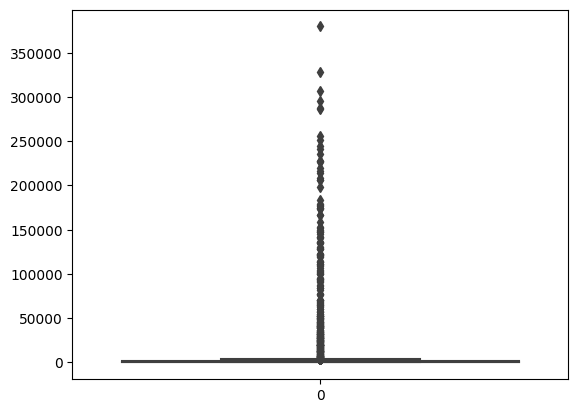

In [ ]:
sns.boxplot(df["Flight Distance"])

95-й перцентиль перемнной Flight Distance ≈ 3400 миль, однако есть огромные выбросы справа

Длина экватора ≈ 25 тыс. миль, однако как правило нет причины (при доступности воздушного пространства) пролетать всё расстояние в одном направлении, т.е. если, например, длина пути в восточном направлении > половины длины экватора, быстрее достигнуть этой точки, сменив курс на западное направление.

Отсюда, разумная верхняя граница для переменной ≈ 12.5 тыс. миль

----
__Что касается переменных Age и Delays__:
- Для Age возьмём cut-off point в 100 (можно было бы по перцентилю, но и пожилых людей в принципе закономерно не очень много)
- Для Arrival/Departure Delay in Minutes возьмём следующий cut-off point. Посчитаем абсолютную разницу между задержкой в отправлении и прибытии. Оставим только те наблюдения, для которых:

  - эта разница меньше её 99 перцентиля И
  - arrival/departure delay одновременно <= двух суток


### Cleaning, feature engineering

In [ ]:
class FlightTransformer(BaseEstimator, TransformerMixin):
  def __init__(self, method):
    self.method = method
    self.columns_cat = ["Gender", "Customer Type", "Type of Travel", "Class"]
    self.columns_num = ["Age", "Flight Distance", "Departure Delay in Minutes", "Arrival Delay in Minutes"]
    self.columns_rating = ['Inflight wifi service','Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']
    self.delay_quantile = None

  def fit(self, X, y=None):
    return self

  def transform(self, X, y=None):
    if self.method == "drop":

      for column_rating in self.columns_rating:
        X = X[(X[column_rating] <= 5) |
              X[column_rating].isna()]

      X = X[X['Age'] <= 100]
      X = X[X['Flight Distance'] <= 12500]

      __sub_df = X[['Arrival Delay in Minutes', 'Departure Delay in Minutes']]
      self.delay_quantile = np.nanquantile(__abs_diff := abs(__sub_df['Arrival Delay in Minutes'] - __sub_df['Departure Delay in Minutes']), 0.99)
      # 2880 = 60 * 48 (кол-во минут в двух сутках)
      __arr_del_cond = (X['Arrival Delay in Minutes'] < 2800) | (X['Arrival Delay in Minutes'].isna())
      __dep_del_cond = (X['Departure Delay in Minutes'] < 2800) | (X['Departure Delay in Minutes'].isna())

      X = X[(__abs_diff <= self.delay_quantile)  & (__arr_del_cond) & (__dep_del_cond)]
      X[self.columns_cat] = X[self.columns_cat].fillna('')

      return X


### Разделение данных, пайплайн предобработки

In [141]:
df = df[df['satisfaction'] != '-']
X_train, X_test, y_train, y_test = train_test_split(df.drop('satisfaction', axis=1), df['satisfaction'], test_size=0.2, random_state=42)

In [ ]:
pipe_drop = Pipeline(
    steps = [
        ("drop_corrupted",  FlightTransformer("drop"))
    ]
)

X_train = pipe_drop.fit_transform(X_train)
y_train = y_train[X_train.index]
X_test[cat_features] = X_test[cat_features := ["Gender", "Customer Type", "Type of Travel", "Class"]].fillna("")

X_train[cat_features] = X_train[cat_features].astype("category")
X_test[cat_features] = X_test[cat_features].astype("category")

In [ ]:
X = X_train.copy()
y = y_train.copy()

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

In [ ]:
X.shape, y.shape

((80962, 22), (80962,))

Я не делаю никакой обработки для теста на данном этапе, кроме замены категориальных пропусков на пустую строку, поскольку в варианте с примитивной обработкой мы просто чистим трейн от выбросов (т.е. трансформации выбросов или переменных в целом не происходит)

### Тюнинг гиперпараметров

Посмотрим на качество модели без оптимизации параметров

In [ ]:
def get_accuracy_naive(X_, y_, X_test_, y_test_):
  EARLY_STOPPING_ROUND = 100


  X_train, X_val, y_train, y_val = train_test_split(X_, y_, test_size=0.1)

  cat_features = ["Gender", "Customer Type", "Type of Travel", "Class"]
  naive_cl = CatBoostClassifier(learning_rate=0.1,
                                          depth=6,
                                          l2_leaf_reg=4,
                                          min_child_samples=16,
                                          grow_policy='Depthwise',
                                          iterations=10000,
                                          use_best_model=True,
                                          eval_metric='Logloss',
                                          od_type='iter',
                                          od_wait=20,
                                          random_state=42,
                                          logging_level='Silent',
                                          cat_features=cat_features)
  naive_cl.fit(X_train.copy(), y_train.copy(),
                    eval_set=Pool(
                        X_val.copy(), y_val.copy(), cat_features=cat_features),
                    early_stopping_rounds=EARLY_STOPPING_ROUND)


  pred_train = naive_cl.predict(X_)
  pred_test = naive_cl.predict(X_test_)


  return confusion_matrix(y_, pred_train), confusion_matrix(y_test_, pred_test)






In [153]:
def metrics_from_matrix(ma):
  accuracy = (ma[0][0] + ma[1][1]) / ma.sum()
  precision = ma[0][0] / (ma[0][0] + ma[0][1])
  recall = ma[0][0] / (ma[0][0] + ma[1][0])
  specificity = ma[1][1] / (ma[1][1] + ma[0][1])
  return accuracy, precision, recall, specificity

def print_results(results):
  for i, set_name in enumerate(['train', 'test']):
    metrics_names = ['accuracy', 'precision', 'recall', 'specificity']
    metrics = metrics_from_matrix(results[i])
    print(f"Results for the {set_name} set are:\n")
    for j, metric_name in enumerate(metrics_names):
      print(f"{metric_name} is {metrics[j]:.5f}")
    print("-------")

In [ ]:
conf_train, conf_test = get_accuracy_naive(X, y, X_test, y_test)

In [ ]:
print_results([conf_train, conf_test])

Results for the train set are:

accuracy is 0.97776
precision is 0.98866
recall is 0.97259
specificity is 0.98479
-------
Results for the test set are:

accuracy is 0.96285
precision is 0.97884
recall is 0.95656
specificity is 0.97151
-------


Неплохо! Посмотрим, можем ли мы лучше после подбора гиперпараметров

In [ ]:
def objective(trial):
  # EARLY_STOPPING_ROUND = 100

  cat_features = ["Gender", "Customer Type", "Type of Travel", "Class"]
  param = {}

  param['learning_rate'] = trial.suggest_float("learning_rate", 0.001, 0.1, log=True)
  param['depth'] = trial.suggest_int('depth', 4, 10)
  param['iterations'] = trial.suggest_int("iterations", 100, 1000)
  param['l2_leaf_reg'] = trial.suggest_float("l2_leaf_reg", 1e-6, 100.0, log=True)
  param['min_child_samples'] = trial.suggest_categorical('min_child_samples', [1, 4, 8, 16, 32])
  param['bootstrap_type']=trial.suggest_categorical("bootstrap_type", ["Bayesian"])
  param['random_strength']=trial.suggest_float("random_strength", 1e-8, 10.0, log=True)
  param['bagging_temperature']=trial.suggest_float("bagging_temperature", 0.0, 10.0)
  param['od_type']=trial.suggest_categorical("od_type", ["IncToDec", "Iter"])
  param['od_wait']=trial.suggest_int("od_wait", 10, 50)
  param['grow_policy'] = 'Depthwise'
  param['use_best_model'] = True
  param['eval_metric'] = 'Logloss'
  param['random_state'] = 42
  param['logging_level'] = 'Silent'
  param['cat_features'] = cat_features

  clf = CatBoostClassifier(**param)

  clf.fit(X_train.copy(), y_train.copy(),
                eval_set=Pool(
                    X_val.copy(), y_val.copy(), cat_features))

  pred_test = clf.predict(X_test)

  return accuracy_score(y_test, pred_test)

In [ ]:
study = optuna.create_study(study_name="flights_naive_preproc", direction="maximize", sampler=TPESampler())
study.optimize(objective, n_trials=100)

[I 2023-06-29 12:57:19,081] A new study created in memory with name: flights_naive_preproc
[I 2023-06-29 12:57:31,010] Trial 0 finished with value: 0.9514941533131226 and parameters: {'learning_rate': 0.031208603380339855, 'depth': 8, 'iterations': 203, 'l2_leaf_reg': 3.896738132608864, 'min_child_samples': 32, 'bootstrap_type': 'Bayesian', 'random_strength': 0.0018093541993404283, 'bagging_temperature': 4.11913362429951, 'od_type': 'Iter', 'od_wait': 20}. Best is trial 0 with value: 0.9514941533131226.
[I 2023-06-29 12:59:31,657] Trial 1 finished with value: 0.9602521534093643 and parameters: {'learning_rate': 0.03033418083289658, 'depth': 10, 'iterations': 856, 'l2_leaf_reg': 0.2777494836203857, 'min_child_samples': 1, 'bootstrap_type': 'Bayesian', 'random_strength': 0.03899339448524548, 'bagging_temperature': 5.101609897591377, 'od_type': 'IncToDec', 'od_wait': 11}. Best is trial 1 with value: 0.9602521534093643.
[I 2023-06-29 12:59:44,913] Trial 2 finished with value: 0.95014676868

In [127]:
# сохраним study
# from google.colab import drive
# drive.mount('/content/drive/')

# with open("drive/MyDrive/bootcamp_mlservice_flights/study_hypers_naive.pickle", "wb") as f:
#   pickle.dump(study, f)

# загружаем study
with open("drive/MyDrive/bootcamp_mlservice_flights/study_hypers_naive.pickle", "rb") as f:
  study = pickle.load(f)

In [ ]:
study.best_trial.value

0.962561955632549

Полученный accuracy не сильно отличается от модели с неоптимальными параметрами (в случае модели без тюнинга мы вполне могли получить accuracy выше на тесте из-за разного random state, т.к. не фиксировали его в optun'е).

Посмотрим на study подробнее

In [ ]:
optuna.visualization.plot_optimization_history(study)

In [ ]:
optuna.visualization.plot_param_importances(study)

In [128]:
print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))



Best trial:
  Value: 0.962561955632549
  Params: 
    learning_rate: 0.03166547966729767
    depth: 7
    iterations: 884
    l2_leaf_reg: 0.0009289116273197389
    min_child_samples: 1
    bootstrap_type: Bayesian
    random_strength: 0.0009894830276068584
    bagging_temperature: 0.27386746524225336
    od_type: Iter
    od_wait: 48


In [129]:
# сохраним параметры
# from google.colab import drive
# drive.mount('/content/drive/')

with open("drive/MyDrive/bootcamp_mlservice_flights/best_params.pickle", "wb") as f:
  pickle.dump(trial.params, f)

#### Выводы из тюнинга

- Оптимальное accuracy на лучших trial'ах находится в довольно близкой 0.96 окрестности. Если после imputation'a через медиану или knn (вместо дропа пропусков (для категориальных фичей), а также игнорирования пропусков и дропа выбросов (для количественных фичей)) accuracy не поднимется, можно посмотреть, на каких объектах модель ошибается (и попробовать достать что-то оттуда)
- learning rate, температура, кол-во итераций и минимум объектов в листьях - наиболее важные hypers, что в целом ожидаемо

### Построение модели

Обучим классификатор с оптимальными параметрами и посмотрим дополнительно на feature importance

In [137]:
study.best_trial.params

{'learning_rate': 0.03166547966729767,
 'depth': 7,
 'iterations': 884,
 'l2_leaf_reg': 0.0009289116273197389,
 'min_child_samples': 1,
 'bootstrap_type': 'Bayesian',
 'random_strength': 0.0009894830276068584,
 'bagging_temperature': 0.27386746524225336,
 'od_type': 'Iter',
 'od_wait': 48}

In [135]:
def get_accuracy_optimal(X, y, X_train, y_train, X_val, y_val, study):
  EARLY_STOPPING_ROUND = 100



  cat_features = ["Gender", "Customer Type", "Type of Travel", "Class"]
  optimal_params = study.best_trial.params
  optimal_cl = CatBoostClassifier(**optimal_params,
                                          grow_policy='Depthwise',
                                          use_best_model=True,
                                          eval_metric='Logloss',
                                          random_state=100,
                                          logging_level='Silent',
                                          cat_features=cat_features)
  optimal_cl.fit(X_train.copy(), y_train.copy(),
                    eval_set=Pool(
                        X_val.copy(), y_val.copy(), cat_features=cat_features),
                    early_stopping_rounds=EARLY_STOPPING_ROUND)


  pred_train = optimal_cl.predict(X)
  pred_test = optimal_cl.predict(X_test)


  return confusion_matrix(y, pred_train), confusion_matrix(y_test, pred_test), optimal_cl


In [ ]:
conf_train, conf_test, optimal_cl = get_accuracy_optimal(X, y, X_train, y_train, X_val, y_val, study)

In [ ]:
print_results([conf_train, conf_test])

Results for the train set are:

accuracy is 0.97616
precision is 0.98808
recall is 0.97039
specificity is 0.98403
-------
Results for the test set are:

accuracy is 0.96256
precision is 0.97951
recall is 0.95546
specificity is 0.97238
-------


Результаты примерно на том же уровне; посмотрим на feature importance

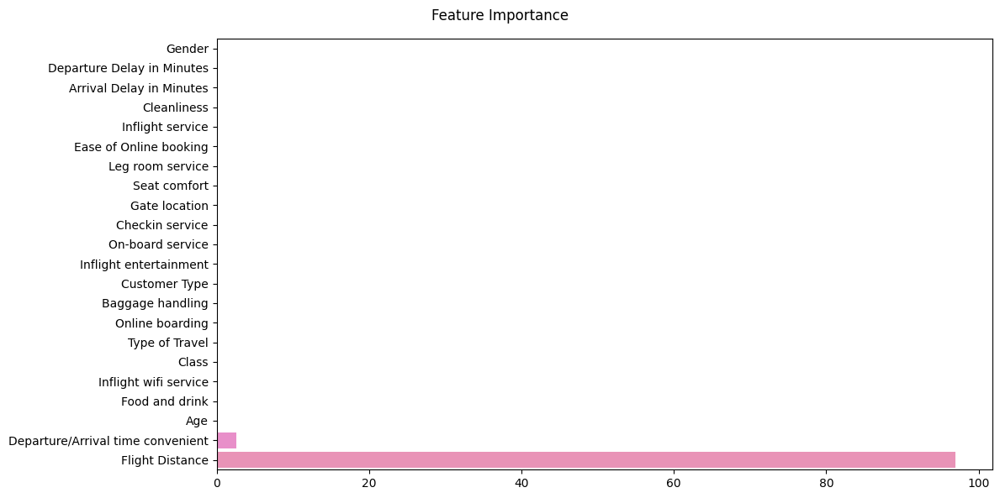

In [ ]:
# random_seed 42
feature_importance = optimal_cl.get_feature_importance()
sorted_idx = np.argsort(feature_importance)
fig, axs = plt.subplots(1, 1, figsize=(12, 6))
sns.barplot(x=feature_importance[sorted_idx], y=np.array(X_test.columns)[sorted_idx])
fig.suptitle('Feature Importance')
plt.tight_layout()

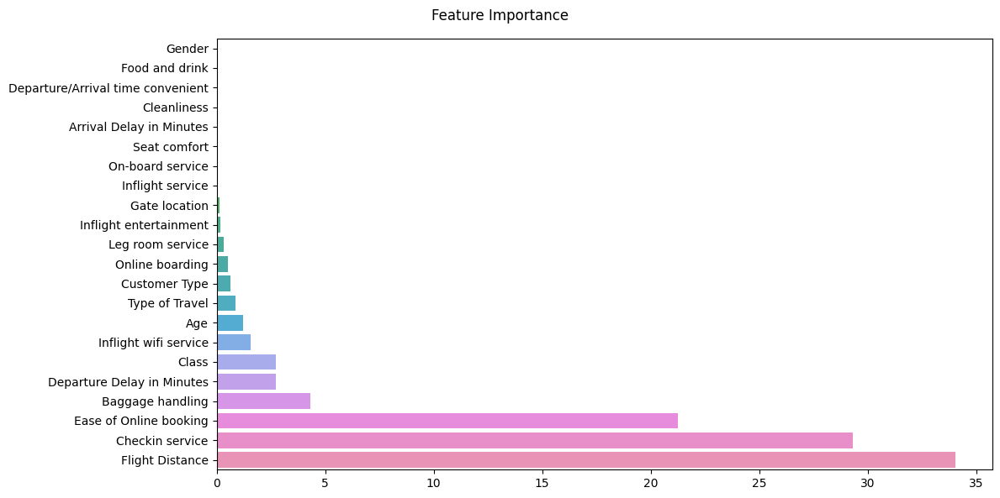

In [ ]:
# random_seed = 100
feature_importance = optimal_cl.get_feature_importance()
sorted_idx = np.argsort(feature_importance)
fig, axs = plt.subplots(1, 1, figsize=(12, 6))
sns.barplot(x=feature_importance[sorted_idx], y=np.array(X_test.columns)[sorted_idx])
fig.suptitle('Feature Importance')
plt.tight_layout()

Посмотрим дополнительно на SHAP values

Из-за стохастической природы алгоритма мы можем получать разные значения важности признаков, фиксируя разный random_seed (показано выше двумя графиками, а также ниже, при построении обучении моделей с разными сидами)



In [ ]:
explainer = shap.Explainer(optimal_cl)

In [ ]:
shap_values = explainer(X_test)

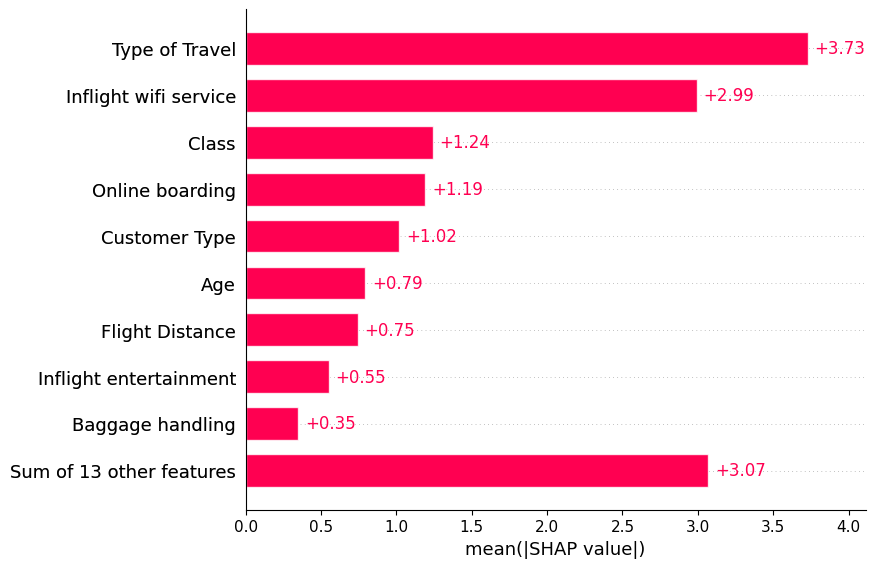

In [ ]:
shap.plots.bar(shap_values)

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


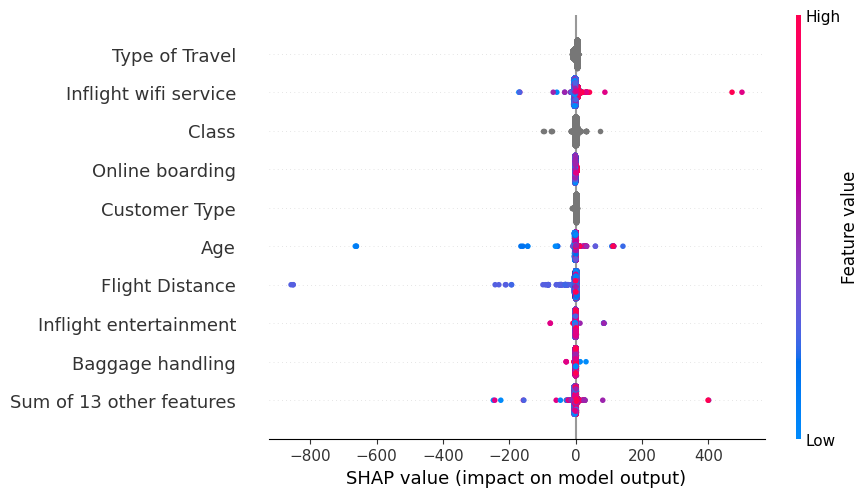

In [ ]:
shap.plots.beeswarm(shap_values)

In [ ]:
optimal_cl.classes_

array(['neutral or dissatisfied', 'satisfied'], dtype=object)

In [ ]:
explainer2 = shap.Explainer(optimal_cl)
shap_values2 = explainer2(X_test)

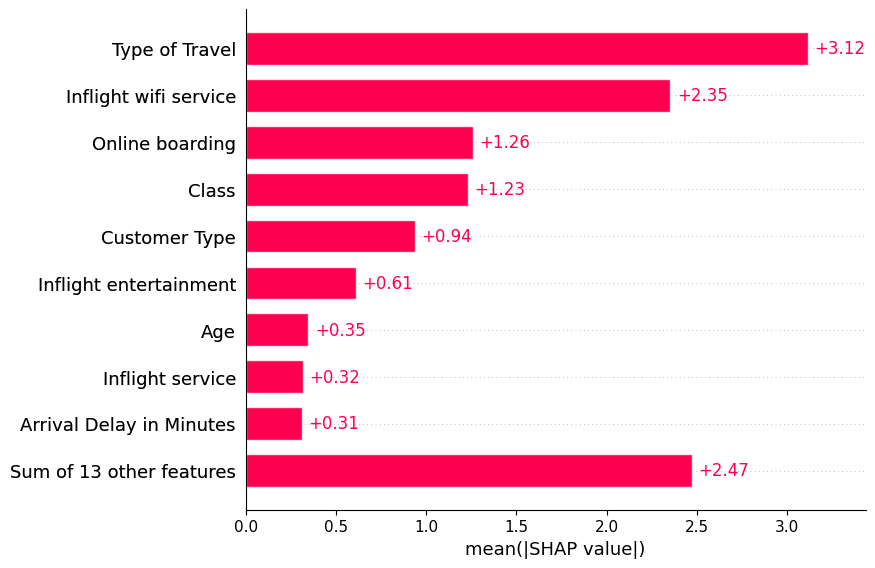

In [ ]:
shap.plots.bar(shap_values2)

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


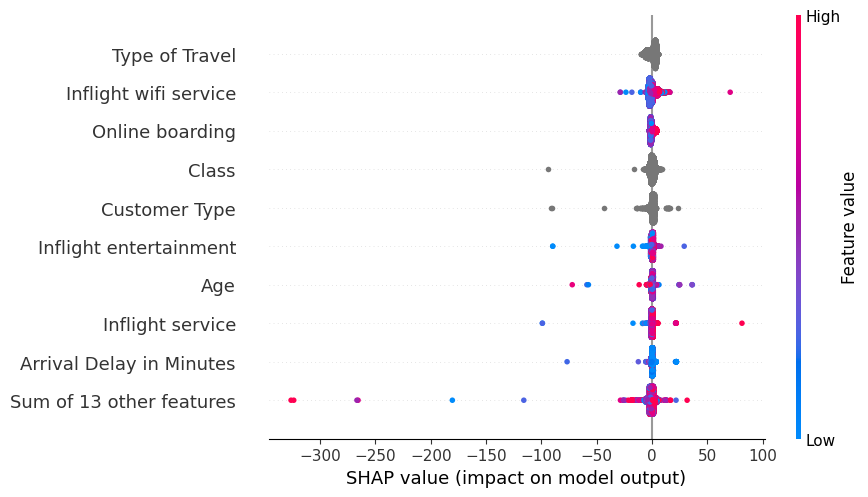

In [ ]:
shap.plots.beeswarm(shap_values2)

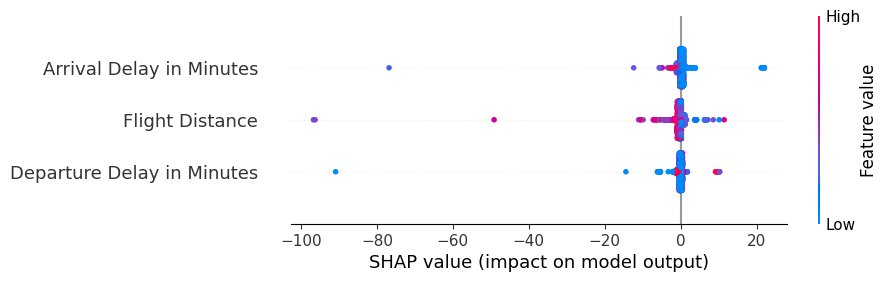

In [ ]:
shap.plots.beeswarm(shap_values2[:, [5, 6, 7]])

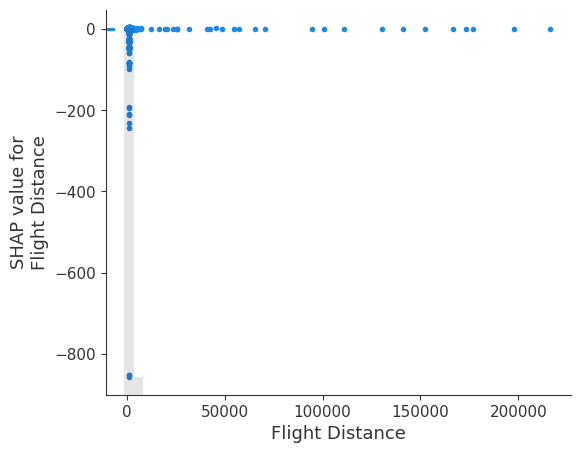

In [ ]:
shap.plots.scatter(shap_values[:,"Flight Distance"]) # для random seed 42

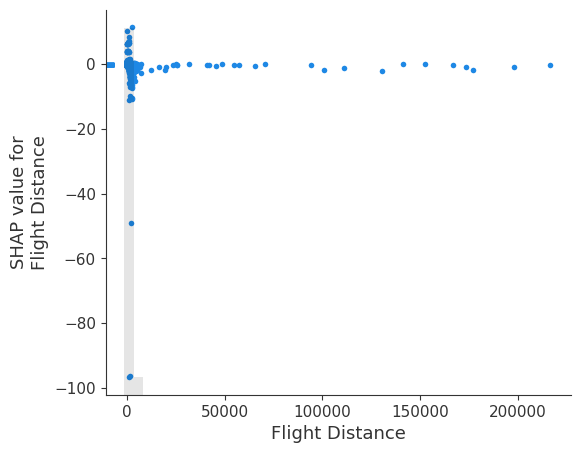

In [ ]:
shap.plots.scatter(shap_values2[:,"Flight Distance"]) # для random seed 100

#### Выводы из анализа важности фичей

По-хорошему, из-за стохастической природы леса для получения лучшего общего представления о важности фичей неплохо обучать модель много раз с разными случайными сидами и или *а)* усреднять важность фичей от прогона к прогону, или *б)* смотреть то, как в среднем эти фичи отранжированы

SHAP-значения (из-за разных конфигураций модели от прогона к прогону) будут в этом смысле также довольно сильно отличаться



### Последняя модель - с заполнением пропущенных значений вместо дропа

#### Предобработка

Новый пайплайн предобработки выглядит следующим образом:

- Перевести выбросы в пропуски
- Заменить пропуски через KNNImputer

In [72]:
class FlightNanCreator(BaseEstimator, TransformerMixin):
  def __init__(self):
    self.columns_cat = ["Gender", "Customer Type", "Type of Travel", "Class"]
    self.columns_num = ["Age", "Flight Distance", "Departure Delay in Minutes", "Arrival Delay in Minutes"]
    self.columns_rating = ['Inflight wifi service','Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']
    self.delay_quantile = None

  def fit(self, X, y=None):
    __sub_df = X[['Arrival Delay in Minutes', 'Departure Delay in Minutes']]
    self.delay_quantile = np.nanquantile(abs(__sub_df['Arrival Delay in Minutes'] - __sub_df['Departure Delay in Minutes']), 0.99)
    return self

  def transform(self, X, y=None):

    for column_rating in self.columns_rating:
      X[(X[column_rating] > 5) | X[column_rating].isna()] = np.nan

    X[X['Age'] > 100] = np.nan
    X[X['Flight Distance'] > 12500] = np.nan


    # 2880 = 60 * 48 (кол-во минут в двух сутках)
    __arr_del_cond = (X['Arrival Delay in Minutes'] >= 2800) | (X['Arrival Delay in Minutes'].isna())
    __dep_del_cond = (X['Departure Delay in Minutes'] >= 2800) | (X['Departure Delay in Minutes'].isna())
    __sub_df = X[['Arrival Delay in Minutes', 'Departure Delay in Minutes']]
    __abs_diff = abs(__sub_df['Arrival Delay in Minutes'] - __sub_df['Departure Delay in Minutes'])

    X[(__abs_diff > self.delay_quantile)  & (__arr_del_cond) & (__dep_del_cond)] = np.nan

    return X



Я бы хотел, чтобы в трейне и тесте сохранялись пропорции категориальных переменных, т.к. не каждая из этих переменных сбалансирована, однако каждая переменная содержит пропуски.

Для обхода:
- переведем временно nan значения в строку 'nanvalue'
- объединим категориальные переменные в одну фичу через делиметер
- разделим датасет с стратификацией этой фичи
- удалим вспомогательную для разделения фичу
- переведём 'nanvalue' в nan


In [8]:
df = df.fillna("nanvalue")
X, y = df.drop("satisfaction", axis=1), df['satisfaction']
X[["Gender", "Customer Type", "Type of Travel", "Class"]] = X[cat_vals := ["Gender", "Customer Type", "Type of Travel", "Class"]]
X['Composite'] = X[cat_vals].astype(str).apply('_'.join, axis=1)

# уберем классы, встречающиеся только два раза
composite_counts = X['Composite'].value_counts()
class_ones = composite_counts[(composite_counts < 2)].index
X = X[bad_mask := ~X['Composite'].isin(class_ones)]
y = y[bad_mask]

X, X_test, y, y_test = train_test_split(X, y, test_size=0.2, stratify=X['Composite'], random_state=42)
X = X.drop("Composite", axis=1).replace("nanvalue", np.nan)
X_test = X_test.drop("Composite", axis=1).replace("nanvalue", np.nan)



Проблема с использованием KNNImputer'а для категориальных переменных состоит в том, что KNN не обрабатывает категориальные переменные из коробки

Для обхода воспользуемся метрикой [gower distance](https://jamesmccaffrey.wordpress.com/2020/04/21/example-of-calculating-the-gower-distance/.), написав для неё класс

In [119]:
class GowerImputer(BaseEstimator, TransformerMixin):
  def __init__(self, cat_vals=None, n=10):
    self.cat_vals = cat_vals
    self.gower_lookup = None
    self.n = n
    self.lookup_hash = None

  def fit(self, X, y=None):
    self.gower_lookup = X.copy()
    self.lookup_hash = joblib.hash(X.copy())
    return self

  def transform(self, X, y=None):
    hashes_unequal = joblib.hash(X) != self.lookup_hash
    X_nas = X[np.any(X.isna(), axis=1)].copy()
    nan_indices = X_nas.index
    for i in tqdm(range(X_nas.shape[0]), desc='Processing NAs'):
      __top_n = gower.gower_topn(na_row := X_nas.iloc[i:i+1, :].copy(), self.gower_lookup, n=self.n)  # не использую iterrows, т.к. gower_topn принимает на вход DataFrame, а каждый раз кастовать Series не хочется

      # если смотреть на топ-к похожих объектов для трейна, наиболее похожим будет сам объект (т.к. трейн fitted to self.gower_lookup)
      # поэтому его надо выбрасывать при fit_transform, но оставлять для transform

      top_n_indx = __top_n['index'][int(hashes_unequal):]

      na_cols = X.columns[na_row.isna().values.flatten()]
      __top_n_df = self.gower_lookup.iloc[top_n_indx].copy()

      numeric_imputs = np.nanmean(__top_n_df.loc[:, numeric_colind := ~__top_n_df.columns.isin(self.cat_vals)], axis=0)

      categorical_imputs = __top_n_df[self.cat_vals].value_counts().idxmax()
      X_nas.iloc[i:i+1, numeric_colind] = numeric_imputs
      X_nas.iloc[i:i+1, ~numeric_colind] = categorical_imputs
    X.loc[nan_indices] = X_nas
    return X

In [120]:
pipe = Pipeline(steps=[
    ["outliers_to_nas", FlightNanCreator()],
    ["KNNImputer", GowerImputer(cat_vals=cat_vals)]
])

In [122]:
X_transformed = pipe.fit_transform(X)

Processing NAs:   0%|          | 0/2657 [00:00<?, ?it/s]

In [125]:
X_test_transformed = pipe.transform(X_test)

Processing NAs:   0%|          | 0/697 [00:00<?, ?it/s]

In [126]:
# сохраним обработанные датасеты
# from google.colab import drive
# drive.mount('/content/drive/')

with open("drive/MyDrive/bootcamp_mlservice_flights/processed_data.pickle", "wb") as f:
  pickle.dump({"X": X_transformed, "y": y,
               "X_test": X_test_transformed, "y_test": y_test}, f)

#### Обучение

In [147]:
# загрузка гиперпараметров
with open("drive/MyDrive/bootcamp_mlservice_flights/best_params.pickle", "rb") as f:
  params = pickle.load(f)

# загрузка обработанных датасетов
with open("drive/MyDrive/bootcamp_mlservice_flights/processed_data.pickle", "rb") as f:
  datasets_processed = pickle.load(f)
  X = datasets_processed['X']
  y = datasets_processed['y']
  X_test = datasets_processed['X_test']
  y_test = datasets_processed['y_test']

In [148]:
# я немного поменял сигнатуру, чтобы не загружать study целиком, а только словарь параметров

y = y[(sane_mask := (y != '-'))]
y_test = y_test[(sane_mask2 := (y_test != '-'))]
X = X_transformed[sane_mask]
X_test = X_test[sane_mask2]


X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)
def get_accuracy_optimal(X, y, X_train, y_train, X_val, y_val, params):
  EARLY_STOPPING_ROUND = 100



  cat_features = ["Gender", "Customer Type", "Type of Travel", "Class"]
  optimal_params = params
  optimal_cl = CatBoostClassifier(**optimal_params,
                                          grow_policy='Depthwise',
                                          use_best_model=True,
                                          eval_metric='Logloss',
                                          random_state=42,
                                          logging_level='Silent',
                                          cat_features=cat_features)
  optimal_cl.fit(X_train.copy(), y_train.copy(),
                    eval_set=Pool(
                        X_val.copy(), y_val.copy(), cat_features=cat_features),
                    early_stopping_rounds=EARLY_STOPPING_ROUND)


  pred_train = optimal_cl.predict(X)
  pred_test = optimal_cl.predict(X_test)


  return confusion_matrix(y, pred_train), confusion_matrix(y_test, pred_test), optimal_cl


In [149]:
conf_train, conf_test, optimal_cl = get_accuracy_optimal(X, y, X_train, y_train, X_val, y_val, params)

In [155]:
# сохраним модель
with open("drive/MyDrive/bootcamp_mlservice_flights/flight_classifier.pickle", "wb") as f:
  pickle.dump(optimal_cl, f)

#### Оценка качества

In [154]:
print_results([conf_train, conf_test])

Results for the train set are:

accuracy is 0.97179
precision is 0.99067
recall is 0.96075
specificity is 0.98730
-------
Results for the test set are:

accuracy is 0.95683
precision is 0.98263
recall is 0.94362
specificity is 0.97592
-------


### Выводы и обсуждение результатов

- Несмотря на неплохое качество (accuracy), можно всё ещё думать над улучшениями модели (экспериментируя с архитектурами и/или обработкой)
- Стоит сгенерировать относительно устойчивые feature importances (например, усредняя importances в терминах CatBoost или Shapley по всем прогонам с разными сидами) - это может помочь как в понимании важности фичей самой по себе, так и в нахождении какого-то подпространства, для которого можно строить отдельную модель